In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from scipy import stats
import warnings
warnings.filterwarnings('ignore')

In [2]:
data = pd.read_excel('AirQualityUCI.xlsx')
data.replace(-200, np.nan, inplace=True)
data.dropna(subset=['C6H6(GT)', 'Date', 'Time'] ,axis=0, inplace=True)

In [3]:
data.set_index(['Date', 'Time'], inplace=True)

In [4]:
from pandas_profiling import ProfileReport
report = ProfileReport(data, title='AirQuality')

In [5]:
report.to_notebook_iframe()

## TODO

- Impute missing values in the dataset
- NMHC(GT) has more than 90% missing values, drop it
- Check correlation with target in the data



In [6]:
TARGET = 'C6H6(GT)'
SEED = 13

In [7]:
y = data[TARGET]
X = data.drop([TARGET,'NMHC(GT)'] , axis=1)

In [8]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, shuffle=False, random_state=SEED)

## Preprocessing

- Imputing missing values in the data
- Normalizing numerical features

In [9]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

prep = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler',  StandardScaler())
    
])


In [10]:
def adj_r2(y, pr, x):
    n, p = x.shape
    return 1-(1-r2(y, pr))*(n-1)/(n-p-1)

<AxesSubplot:>

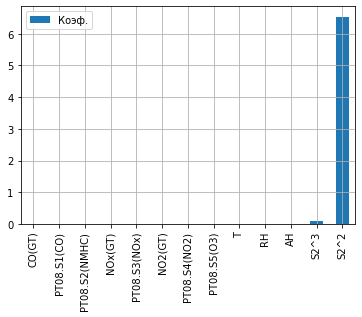

In [112]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet

from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import r2_score as r2

model = Lasso(random_state=SEED)

pipeline = Pipeline(steps=[
    ('prep', prep),
    ('model', model)
])

pipeline.fit(X_train, y_train)

coef = pd.DataFrame(pipeline[1].coef_, X_train.columns).sort_values(by=0)
coef.columns = ['Коэф.']
coef.plot.bar(grid=True)

## Non-linear transformations


- Add quadratic and cubic features for PT08.S2 (chosen via L1 regularization model)

In [12]:
X_train['S2^2'] = X_train['PT08.S2(NMHC)'] ** 2
X_test['S2^2'] = X_test['PT08.S2(NMHC)'] ** 2
X_train['S2^3'] = X_train['PT08.S2(NMHC)'] ** 3
X_test['S2^3'] = X_test['PT08.S2(NMHC)'] ** 3

## Baseline

Linear regression without regularization

### Linear regression w\o regularization

Linear regression, mae 0.011456930921819077
Linear regression, mse 0.0003942405472237495
Linear regression, r^2 0.9999906408658633
Linear regression, adjusted r^2 0.9999905864035787


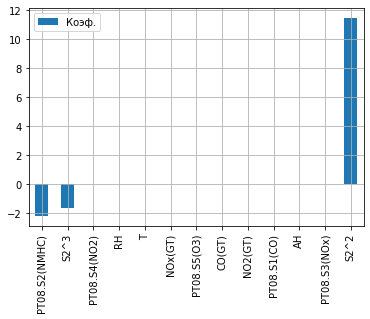

In [115]:
model = LinearRegression()

pipeline = Pipeline(steps=[
    ('prep', prep),
    ('model', model)
])

pipeline.fit(X_train, y_train)
preds = pipeline.predict(X_test)

coef = pd.DataFrame(pipeline[1].coef_, X_train.columns).sort_values(by=0)
coef.columns = ['Коэф.']
coef.plot.bar(grid=True)

print('Linear regression, mae', mae(y_test, preds))
print('Linear regression, mse', mse(y_test, preds))
print('Linear regression, r^2', r2(y_test, preds))
print('Linear regression, adjusted r^2', adj_r2(y_test, preds, X_test))



### Linear regression w/ regularization,  Cross-validation for Elastic Net

L2, sklearn, mae 0.06409730341799619
L2, mse 0.010917991071996107
L2, r^2 0.9997408106708835
L2, adjusted r^2 0.9997393024071062


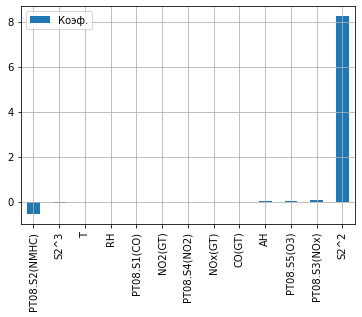

In [116]:
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV

model = Ridge(random_state=SEED)
pipeline = Pipeline(steps=[
    ('prep', prep),
    ('model', model)
])

pipeline.fit(X_train, y_train)
preds= pipeline.predict(X_test)

coef = pd.DataFrame(pipeline[1].coef_, X_train.columns).sort_values(by=0)
coef.columns = ['Коэф.']
coef.plot.bar(grid=True)

print('L2, sklearn, mae', mae(y_test, preds))
print('L2, mse', mse(y_test, preds))
print('L2, r^2', r2(y_test, preds))
print('L2, adjusted r^2', adj_r2(y_test, preds, X_test))



Elastic Net, mae 1.0267914585311502
Elastic Net, mse 1.52955557343852
Elastic Net, r^2 0.9636888800960122
Elastic Net, adjusted r^2 0.9634775799354249


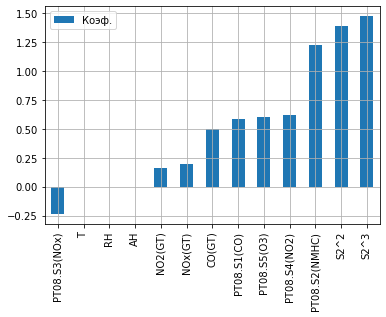

In [117]:
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV

model = ElasticNet(random_state=SEED)
pipeline = Pipeline(steps=[
    ('prep', prep),
    ('model', model)
])

pipeline.fit(X_train, y_train)
preds= pipeline.predict(X_test)

coef = pd.DataFrame(pipeline[1].coef_, X_train.columns).sort_values(by=0)
coef.columns = ['Коэф.']
coef.plot.bar(grid=True)

print('Elastic Net, mae', mae(y_test, preds))
print('Elastic Net, mse', mse(y_test, preds))
print('Elastic Net, r^2', r2(y_test, preds))
print('Elastic Net, adjusted r^2', adj_r2(y_test, preds, X_test))




In [119]:
cv = TimeSeriesSplit()
params = {
    'model__alpha': [0, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1.0, 10.0, 100.0],
    'model__l1_ratio': np.arange(0, 1, 0.01)
}
reg = GridSearchCV(pipeline, cv=cv, scoring='neg_mean_squared_error', param_grid=params)

In [17]:
reg.fit(X_train, y_train)

GridSearchCV(cv=TimeSeriesSplit(max_train_size=None, n_splits=5),
             estimator=Pipeline(steps=[('prep',
                                        Pipeline(steps=[('imputer',
                                                         SimpleImputer(strategy='median')),
                                                        ('scaler',
                                                         StandardScaler())])),
                                       ('model', ElasticNet())]),
             param_grid={'model__alpha': [0, 1e-05, 0.0001, 0.001, 0.01, 0.1,
                                          1.0, 10.0, 100.0],
                         'model__l1_ratio': array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.0...
       0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4 , 0.41, 0.42, 0.43,
       0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5 , 0.51, 0.52, 0.53, 0.54,
       0.55, 0.56, 0.57, 0.58, 0.59, 0.6 , 0.61, 0.62, 0.63, 0.64, 0.65,
       0.66, 0.67, 0.68, 0.69, 0.7 , 0.71, 0.72, 0.73, 0

In [18]:
reg.best_params_

{'model__alpha': 0.01, 'model__l1_ratio': 0.99}

In [37]:
pipeline = Pipeline(steps=[
    ('prep', prep),
    ('model', ElasticNet(alpha=0.01, l1_ratio=0.99))
])

n = 1
for train_index, test_index in cv.split(X_train):
    pipeline.fit(X_train.iloc[train_index],  y_train.iloc[train_index])
    print('Split ', n)
    n += 1
    print('Elastic Net, mse', mse(y_train.iloc[test_index], pipeline.predict(X_train.iloc[test_index])))
    print('Elastic Net, r^2', r2(y_train.iloc[test_index], pipeline.predict(X_train.iloc[test_index])))

Split  1
Elastic Net, mse 0.009784477803972774
Elastic Net, r^2 0.9997991911747718
Split  2
Elastic Net, mse 0.005749361392834867
Elastic Net, r^2 0.9998526042765742
Split  3
Elastic Net, mse 0.006597360460832397
Elastic Net, r^2 0.9997891160252286
Split  4
Elastic Net, mse 0.042099535445683914
Elastic Net, r^2 0.999530935533834
Split  5
Elastic Net, mse 0.0342585565404318
Elastic Net, r^2 0.9995354574731742


Elastic net, mae 0.09303003958107177
Elastic net, mse 0.019110568093985213
Elastic net, r^2 0.9995463217279945
Elastic net, adjusted r^2 0.9995436817022397


<AxesSubplot:>

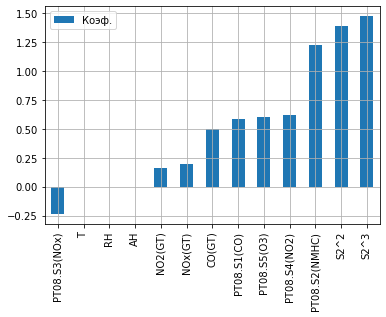

In [20]:
preds = reg.predict(X_test)

print('Elastic net, mae', mae(y_test, preds))
print('Elastic net, mse', mse(y_test, preds))
print('Elastic net, r^2', r2(y_test, preds))
print('Elastic net, adjusted r^2', adj_r2(y_test, preds, X_test))

coef = pd.DataFrame(reg.estimator[1].coef_, X_train.columns).sort_values(by=0)
coef.columns = ['Коэф.']
coef.plot.bar(grid=True)

## Non-classic regressions
- SGD regression
- Kernel regression
- SVM regression

## SGD

In [121]:
from sklearn.linear_model import SGDRegressor



model = SGDRegressor(loss='huber', penalty='elasticnet', random_state=SEED)

pipeline = Pipeline(steps=[
    ('prep', prep),
    ('model', model)
])

# Гиперпараметры уже были подобраны на сетке ниже
params = {
#     'model__alpha': np.array([0, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1.0, 10.0, 100.0]),
#     'model__l1_ratio': np.arange(0, 1, 0.01),
#     'model__max_iter': range(1000, 10000, 1000)
    'model__alpha': [0.01],
    'model__l1_ratio': [0.99],
    'model__max_iter': [3000]
}
reg = GridSearchCV(pipeline, cv=cv, scoring='neg_mean_absolute_error', param_grid=params)
reg.fit(X_train, y_train)

GridSearchCV(cv=TimeSeriesSplit(max_train_size=None, n_splits=5),
             estimator=Pipeline(steps=[('prep',
                                        Pipeline(steps=[('imputer',
                                                         SimpleImputer(strategy='median')),
                                                        ('scaler',
                                                         StandardScaler())])),
                                       ('model',
                                        SGDRegressor(loss='huber',
                                                     penalty='elasticnet',
                                                     random_state=13))]),
             param_grid={'model__alpha': [0.01], 'model__l1_ratio': [0.99],
                         'model__max_iter': [3000]},
             scoring='neg_mean_absolute_error')

In [122]:
reg.best_params_


{'model__alpha': 0.01, 'model__l1_ratio': 0.99, 'model__max_iter': 3000}

In [124]:
pipeline = Pipeline(steps=[
    ('prep', prep),
    ('model', SGDRegressor(alpha=0.01, l1_ratio=0.99, max_iter=3000, penalty='elasticnet', loss='huber', random_state=SEED))
])

n = 1
for train_index, test_index in cv.split(X_train):
    pipeline.fit(X_train.iloc[train_index],  y_train.iloc[train_index])
    print('Split ', n)
    n += 1
    print('SGD, mse', mse(y_train.iloc[test_index], pipeline.predict(X_train.iloc[test_index])))
    print('SGD, mae', mae(y_train.iloc[test_index], pipeline.predict(X_train.iloc[test_index])))
    print('SGD, r^2', r2(y_train.iloc[test_index], pipeline.predict(X_train.iloc[test_index])))

Split  1
SGD, mse 2.6318585302731488
SGD, mae 1.085946871863401
SGD, r^2 0.9459858328446952
Split  2
SGD, mse 0.3472097443288582
SGD, mae 0.44961998377196577
SGD, r^2 0.9910986233167353
Split  3
SGD, mse 0.21754807440534976
SGD, mae 0.27797071177929544
SGD, r^2 0.9930460973131853
Split  4
SGD, mse 0.477308993455273
SGD, mae 0.5052003635527369
SGD, r^2 0.9946819202197569
Split  5
SGD, mse 0.17804228570018932
SGD, mae 0.2823777669437315
SGD, r^2 0.9975857647947485


In [125]:
preds = reg.predict(X_test)

print('SGD, mae', mae(y_test, preds))
print('SGD net, mse', mse(y_test, preds))
print('SGD net, r^2', r2(y_test, preds))
print('SGD, adjusted r^2', adj_r2(y_test, preds, X_test))


SGD, mae 0.20668253883778095
SGD net, mse 0.11422350434365815
SGD net, r^2 0.997288373541896
SGD, adjusted r^2 0.9972725941578515


<AxesSubplot:>

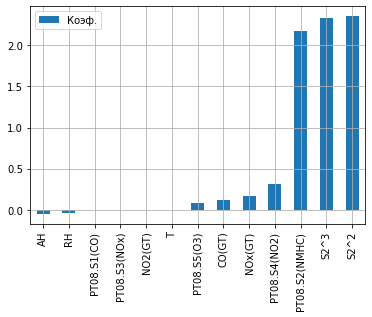

In [126]:
coef = pd.DataFrame(pipeline[1].coef_, X_train.columns).sort_values(by=0)
coef.columns = ['Коэф.']
coef.plot.bar(grid=True)

## Kernel

In [128]:
from sklearn.kernel_ridge import KernelRidge

model = KernelRidge()

pipeline = Pipeline(steps=[
    ('prep', prep),
    ('model', model)
])
params = {
    'model__alpha': [1e-5, 1e-3, 1e-2, 1e-1, 1e1, 1e2, 1e5],
}
reg = GridSearchCV(pipeline, cv=cv, scoring='neg_mean_squared_error', param_grid=params)
reg.fit(X_train, y_train)

GridSearchCV(cv=TimeSeriesSplit(max_train_size=None, n_splits=5),
             estimator=Pipeline(steps=[('prep',
                                        Pipeline(steps=[('imputer',
                                                         SimpleImputer(strategy='median')),
                                                        ('scaler',
                                                         StandardScaler())])),
                                       ('model', KernelRidge())]),
             param_grid={'model__alpha': [1e-05, 0.001, 0.01, 0.1, 10.0, 100.0,
                                          100000.0]},
             scoring='neg_mean_squared_error')

In [79]:
reg.best_params_

{'model__alpha': 0.1}

In [80]:
pipeline = Pipeline(steps=[
    ('prep', prep),
    ('model', KernelRidge(alpha=0.1))
])

n = 1
for train_index, test_index in cv.split(X_train):
    pipeline.fit(X_train.iloc[train_index],  y_train.iloc[train_index])
    print('Split ', n)
    n += 1
    print('SGD, mse', mse(y_train.iloc[test_index], pipeline.predict(X_train.iloc[test_index])))
    print('SGD, mae', mae(y_train.iloc[test_index], pipeline.predict(X_train.iloc[test_index])))
    print('SGD, r^2', r2(y_train.iloc[test_index], pipeline.predict(X_train.iloc[test_index])))

Split  1
SGD, mse 96.57532384438969
SGD, mae 9.826997381984908
SGD, r^2 -0.9820349860017641
Split  2
SGD, mse 104.32378472370901
SGD, mae 10.213880680288304
SGD, r^2 -1.674536991018345
Split  3
SGD, mse 107.04648374341323
SGD, mae 10.346310060914165
SGD, r^2 -2.421730267905725
Split  4
SGD, mse 97.7314290055863
SGD, mae 9.885893017889648
SGD, r^2 -0.08890371565475097
Split  5
SGD, mse 113.91778115009758
SGD, mae 10.673159959297939
SGD, r^2 -0.544713474527226


In [81]:
preds = reg.predict(X_test)

print('Kernel regression, mae', mae(y_test, preds))
print('Kernel regression, mse', mse(y_test, preds))
print('Kernel regression, r^2', r2(y_test, preds))
print('Kernel regression, adjusted r^2', adj_r2(y_test, preds, X_test))

Kernel regression, mae 10.750084419153348
Kernel regression, mse 115.56508832014488
Kernel regression, r^2 -1.7434751973569869
Kernel regression, adjusted r^2 -1.7594399142619292


Линейный Kernel показал плохой результат. Для SVM рассмотрим kernel = poly  

## SVM

In [130]:
from sklearn.svm import SVR

model = SVR(kernel='poly')

pipeline = Pipeline(steps=[
    ('prep', prep),
    ('model', model)
])

params = {
    
#     'model__degree': [2,3],
#     'model__tol': [1e-4, 1e-2, 1e-1],
#     'model__C': [1e-3, 1e-2, 1e1, 1e2]
    'model__degree': [2],
    'model__tol': [1e-2],
    'model__C': [1e-2]
}


reg = GridSearchCV(pipeline, cv=cv, scoring='neg_mean_squared_error', param_grid=params)
reg.fit(X_train, y_train)

GridSearchCV(cv=TimeSeriesSplit(max_train_size=None, n_splits=5),
             estimator=Pipeline(steps=[('prep',
                                        Pipeline(steps=[('imputer',
                                                         SimpleImputer(strategy='median')),
                                                        ('scaler',
                                                         StandardScaler())])),
                                       ('model', SVR(kernel='poly'))]),
             param_grid={'model__C': [0.01], 'model__degree': [2],
                         'model__tol': [0.01]},
             scoring='neg_mean_squared_error')

In [40]:
reg.best_params_


{'model__C': 0.01, 'model__degree': 2, 'model__tol': 0.01}

In [44]:
pipeline = Pipeline(steps=[
    ('prep', prep),
    ('model', SVR(C=0.01, degree=2, tol=0.01, kernel='poly'))
])

n = 1
for train_index, test_index in cv.split(X_train):
    pipeline.fit(X_train.iloc[train_index],  y_train.iloc[train_index])
    print('Split ', n)
    n += 1
    print('SGD, mse', mse(y_train.iloc[test_index], pipeline.predict(X_train.iloc[test_index])))
    print('SGD, mae', mae(y_train.iloc[test_index], pipeline.predict(X_train.iloc[test_index])))
    print('SGD, r^2', r2(y_train.iloc[test_index], pipeline.predict(X_train.iloc[test_index])))

Split  1
SGD, mse 43.31979447579522
SGD, mae 5.349363791152882
SGD, r^2 0.11093905959063488
Split  2
SGD, mse 32.09141066365474
SGD, mae 4.8494341170773305
SGD, r^2 0.17727615863231605
Split  3
SGD, mse 29.1642568945712
SGD, mae 4.442459309615497
SGD, r^2 0.067767412180198
Split  4
SGD, mse 39.16704880965334
SGD, mae 4.851894506917878
SGD, r^2 0.56360870383237
Split  5
SGD, mse 33.35118726748371
SGD, mae 3.8916537268387263
SGD, r^2 0.547761307818285


In [41]:
preds = reg.predict(X_test)

print('SVR, mae', mae(y_test, preds))
print('SVR, mse', mse(y_test, preds))
print('SVR, r^2', r2(y_test, preds))
print('SVR, adjusted r^2', adj_r2(y_test, preds, X_test))

SVR, mae 4.4968340668928075
SVR, mse 27.33418540986957
SVR, r^2 0.3510958992720097
SVR, adjusted r^2 0.34731982348442514


#### Лучшая модель линейная регрессия без регуляризации

Все алгоритмы кроме линейной регрессии не показали значимых результатов

In [97]:
model = LinearRegression()

pipeline = Pipeline(steps=[
    ('prep', prep),
    ('model', model)
])
pipeline.fit(X_train, y_train)
preds = pipeline.predict(X_test)

print('Linear regression, mae', mae(y_test, preds))
print('Linear regression, mse', mse(y_test, preds))
print('Linear regression, r^2', r2(y_test, preds))
print('Linear regression, adjusted r^2', adj_r2(y_test, preds, X_test))

Linear regression, mae 0.011456930921819077
Linear regression, mse 0.0003942405472237495
Linear regression, r^2 0.9999906408658633
Linear regression, adjusted r^2 0.9999905864035787


## Residual analysis

In [98]:
rss = sum((preds - y_test) ** 2)
print('Остаточная сумма квадратов ', rss)
s2 = rss/(len(X_test) - 2)
print('S^2 ', s2)

Остаточная сумма квадратов  0.8862527501589881
S^2  0.0003945916073726572


### Target distribution

<AxesSubplot:xlabel='C6H6(GT)', ylabel='Density'>

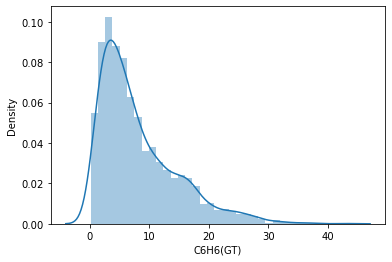

In [131]:
sns.distplot(y_test)

### Residal distribution

<AxesSubplot:xlabel='C6H6(GT)', ylabel='Density'>

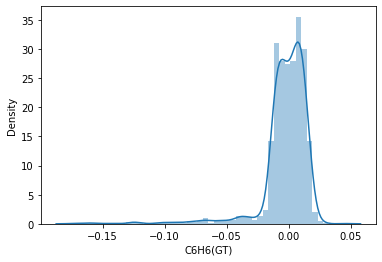

In [99]:
ESS = preds - y_test
sns.distplot(ESS)

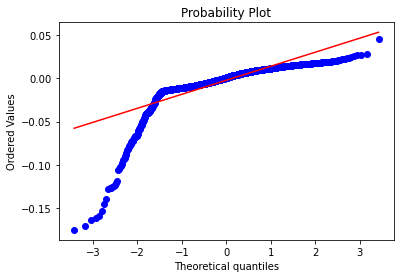

In [100]:
from scipy.stats import probplot
probplot(ESS, plot=plt)
plt.show()

In [101]:
from scipy.stats import anderson

if anderson(ESS, dist='norm').critical_values[2] > anderson(ESS, dist='norm').statistic:
    print('Gaussian dist')
else:
    print('Non-gaussian dist')

Non-gaussian dist


Residues' distribution is not the gaussian alike

### Target vs residuals plot

<AxesSubplot:xlabel='TARGET', ylabel='Residuals'>

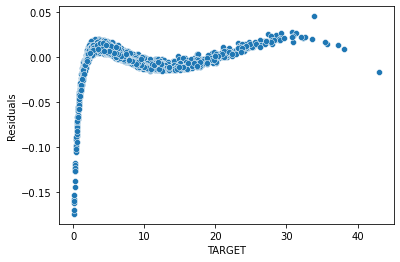

In [109]:
plt.figure()
plt.xlabel('TARGET')
plt.ylabel('Residuals')
sns.scatterplot(y_test, ESS)

#### Predcit vs residual plot

<AxesSubplot:xlabel='Predictions', ylabel='Residuals'>

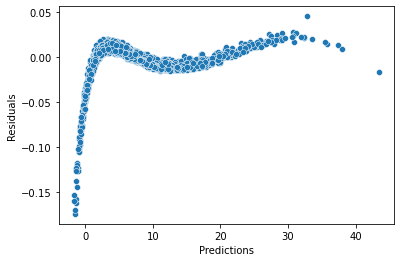

In [132]:
plt.figure()
plt.xlabel('Predictions')
plt.ylabel('Residuals')
sns.scatterplot(preds, ESS)

### Actual vs regression plot

<AxesSubplot:xlabel='TARGET', ylabel='Predictions'>

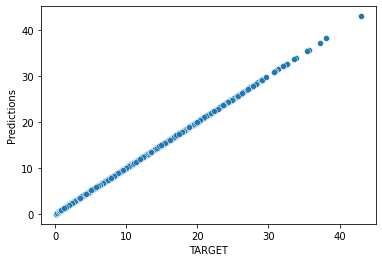

In [111]:
plt.figure()
plt.xlabel('TARGET')
plt.ylabel('Predictions')
sns.scatterplot(y_test, preds)

## Выводы по анализу остатков
- Наибольшие по модулю остатки в районе 0, где сконцетрирован таргет
- 